Name - Akshay Suresh Varma    
Student ID - 23252473

## Assessing Urban Air Quality in Major English Cities Using Geospatial Analysis and Python

#Installing Libraries

In [1]:
pip install contextily

Note: you may need to restart the kernel to use updated packages.


In [2]:
pip install pysal geopandas

Note: you may need to restart the kernel to use updated packages.


In [94]:
!pip install geopandas scipy matplotlib pandas folium

In [3]:
pip install libpysal spreg geopandas pandas

#Importing library packages

In [4]:
import pandas as pd
import numpy as np
import matplotlib as pyplot
import geopandas as gpd
from shapely.geometry import Point
import matplotlib.pyplot as plt
import folium
import matplotlib.dates as mdates
from pysal.lib import weights
from pysal.explore import esda
from libpysal.weights import DistanceBand
from esda.moran import Moran
import matplotlib.pyplot as plt
import statsmodels.api as sm
import libpysal
import spreg
import contextily as ctx
import libpysal as ps
from spreg import GM_Error
from folium import plugins
from folium.plugins import HeatMap
from IPython.display import display

C:\Users\aavar\anaconda3\Lib\site-packages\spaghetti\network.py:42: FutureWarning: The next major release of pysal/spaghetti (2.0.0) will drop support for all ``libpysal.cg`` geometries. This change is a first step in refactoring ``spaghetti`` that is expected to result in dramatically reduced runtimes for network instantiation and operations. Users currently requiring network and point pattern input as ``libpysal.cg`` geometries should prepare for this simply by converting to ``shapely`` geometries.
  warnings.warn(dep_msg, FutureWarning, stacklevel=1)


## Loading the Dataset

In [5]:
air_quality_data = pd.read_excel("D:\Assignments\AirQualityUCI.xlsx")
air_quality_data.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,City
0,2004-03-10,18:00:00,2.6,1360.00,150,11.881723,1045.50,166.0,1056.25,113.0,1692.00,1267.50,13.60,48.875001,0.757754,London
1,2004-03-10,19:00:00,2.0,1292.25,112,9.397165,954.75,103.0,1173.75,92.0,1558.75,972.25,13.30,47.700000,0.725487,London
2,2004-03-10,20:00:00,2.2,1402.00,88,8.997817,939.25,131.0,1140.00,114.0,1554.50,1074.00,11.90,53.975000,0.750239,London
3,2004-03-10,21:00:00,2.2,1375.50,80,9.228796,948.25,172.0,1092.00,122.0,1583.75,1203.25,11.00,60.000000,0.786713,London
4,2004-03-10,22:00:00,1.6,1272.25,51,6.518224,835.50,131.0,1205.00,116.0,1490.00,1110.00,11.15,59.575001,0.788794,London


#Display the data information


In [6]:
air_quality_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9357 entries, 0 to 9356
Data columns (total 16 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   Date           9357 non-null   datetime64[ns]
 1   Time           9357 non-null   object        
 2   CO(GT)         9357 non-null   float64       
 3   PT08.S1(CO)    9357 non-null   float64       
 4   NMHC(GT)       9357 non-null   int64         
 5   C6H6(GT)       9357 non-null   float64       
 6   PT08.S2(NMHC)  9357 non-null   float64       
 7   NOx(GT)        9357 non-null   float64       
 8   PT08.S3(NOx)   9357 non-null   float64       
 9   NO2(GT)        9357 non-null   float64       
 10  PT08.S4(NO2)   9357 non-null   float64       
 11  PT08.S5(O3)    9357 non-null   float64       
 12  T              9357 non-null   float64       
 13  RH             9357 non-null   float64       
 14  AH             9357 non-null   float64       
 15  City           9357 n

#Checking for missing value

In [7]:
air_quality_data.isnull().sum()

Date             0
Time             0
CO(GT)           0
PT08.S1(CO)      0
NMHC(GT)         0
C6H6(GT)         0
PT08.S2(NMHC)    0
NOx(GT)          0
PT08.S3(NOx)     0
NO2(GT)          0
PT08.S4(NO2)     0
PT08.S5(O3)      0
T                0
RH               0
AH               0
City             0
dtype: int64

#Descriptive Analysis

In [8]:
air_quality_data.describe()

,Date,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
count,9357,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000
mean,2004-09-21 04:30:05.193972480,-34.207524,1048.869652,-159.090093,1.865576,894.475963,168.604200,794.872333,58.135898,1391.363266,974.951534,9.776600,39.483611,-6.837604
min,2004-03-10 00:00:00,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000
25%,2004-06-16 00:00:00,0.600000,921.000000,-200.000000,4.004958,711.000000,50.000000,637.000000,53.000000,1184.750000,699.750000,10.950000,34.050000,0.692275
50%,2004-09-21 00:00:00,1.500000,1052.500000,-200.000000,7.886653,894.500000,141.000000,794.250000,96.000000,1445.500000,942.000000,17.200000,48.550000,0.976823
75%,2004-12-28 00:00:00,2.600000,1221.250000,-200.000000,13.636091,1104.750000,284.200000,960.250000,133.000000,1662.000000,1255.250000,24.075000,61.875000,1.296223
max,2005-04-04 00:00:00,11.900000,2039.750000,1189.000000,63.741476,2214.000000,1479.000000,2682.750000,339.700000,2775.000000,2522.750000,44.600000,88.725000,2.231036
std,NaN,77.657170,329.817015,139.789093,41.380154,342.315902,257.424561,321.977031,126.931428,467.192382,456.922728,43.203438,51.215645,38.976670


In [9]:
np.random.seed(0)
air_quality_data['latitude'] = np.random.uniform(low=40.0, high=45.0, size=len(air_quality_data))
air_quality_data['longitude'] = np.random.uniform(low=-75.0, high=-70.0, size=len(air_quality_data))

geometry = [Point(xy) for xy in zip(air_quality_data['longitude'], air_quality_data['latitude'])]

geo_df = gpd.GeoDataFrame(air_quality_data, geometry=geometry)

geo_df.set_crs(epsg=4326, inplace=True)

geo_df.head()


,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,City,latitude,longitude,geometry
0,2004-03-10,18:00:00,2.6,1360.00,150,11.881723,1045.50,166.0,1056.25,113.0,1692.00,1267.50,13.60,48.875001,0.757754,London,42.744068,-71.524376,POINT (-71.52438 42.74407)
1,2004-03-10,19:00:00,2.0,1292.25,112,9.397165,954.75,103.0,1173.75,92.0,1558.75,972.25,13.30,47.700000,0.725487,London,43.575947,-74.767983,POINT (-74.76798 43.57595)
2,2004-03-10,20:00:00,2.2,1402.00,88,8.997817,939.25,131.0,1140.00,114.0,1554.50,1074.00,11.90,53.975000,0.750239,London,43.013817,-74.250896,POINT (-74.25090 43.01382)
3,2004-03-10,21:00:00,2.2,1375.50,80,9.228796,948.25,172.0,1092.00,122.0,1583.75,1203.25,11.00,60.000000,0.786713,London,42.724416,-74.412310,POINT (-74.41231 42.72442)
4,2004-03-10,22:00:00,1.6,1272.25,51,6.518224,835.50,131.0,1205.00,116.0,1490.00,1110.00,11.15,59.575001,0.788794,London,42.118274,-72.593583,POINT (-72.59358 42.11827)


#Air quality map

In [10]:
air_quality_data['Date'] = air_quality_data['Date'].astype(str)
air_quality_data['Time'] = air_quality_data['Time'].astype(str)

air_quality_data['Datetime'] = pd.to_datetime(air_quality_data['Date'] + ' ' + air_quality_data['Time'])
air_quality_data.set_index('Datetime', inplace=True)

if 'latitude' not in air_quality_data.columns or 'longitude' not in air_quality_data.columns:
    np.random.seed(0)
    air_quality_data['latitude'] = np.random.uniform(low=40.0, high=45.0, size=len(air_quality_data))
    air_quality_data['longitude'] = np.random.uniform(low=-75.0, high=-70.0, size=len(air_quality_data))

top_15_data = air_quality_data.head(15)

map_center = [top_15_data['latitude'].mean(), top_15_data['longitude'].mean()]
air_quality_map = folium.Map(location=map_center, zoom_start=12)

for _, row in top_15_data.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=10,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        popup=(
            f"Datetime: {row.name}\n"
            f"CO(GT): {row['CO(GT)']:.2f}\n"
            f"PT08.S1(CO): {row['PT08.S1(CO)']:.2f}\n"
            f"NMHC(GT): {row['NMHC(GT)']:.2f}\n"
            f"C6H6(GT): {row['C6H6(GT)']:.2f}\n"
            f"PT08.S2(NMHC): {row['PT08.S2(NMHC)']:.2f}\n"
            f"NOx(GT): {row['NOx(GT)']:.2f}\n"
            f"PT08.S3(NOx): {row['PT08.S3(NOx)']:.2f}\n"
            f"NO2(GT): {row['NO2(GT)']:.2f}\n"
            f"PT08.S4(NO2): {row['PT08.S4(NO2)']:.2f}\n"
            f"PT08.S5(O3): {row['PT08.S5(O3)']:.2f}\n"
            f"T: {row['T']:.2f}\n"
            f"RH: {row['RH']:.2f}\n"
            f"AH: {row['AH']:.2f}"
        )
    ).add_to(air_quality_map)

air_quality_map

#Descriptive statistic of cities

In [11]:
air_quality_data['Date'] = air_quality_data['Date'].astype(str)
air_quality_data['Time'] = air_quality_data['Time'].astype(str)
air_quality_data['Datetime'] = pd.to_datetime(air_quality_data['Date'] + ' ' + air_quality_data['Time'])
air_quality_data.set_index('Datetime', inplace=True)

if 'latitude' not in air_quality_data.columns or 'longitude' not in air_quality_data.columns:
    np.random.seed(0)
    air_quality_data['latitude'] = np.random.uniform(low=40.0, high=45.0, size=len(air_quality_data))
    air_quality_data['longitude'] = np.random.uniform(low=-75.0, high=-70.0, size=len(air_quality_data))

city_stats = air_quality_data.groupby('City').agg({
    'CO(GT)': ['mean', 'median'],
    'PT08.S1(CO)': 'mean',
    'NMHC(GT)': 'mean',
    'C6H6(GT)': 'mean',
    'PT08.S2(NMHC)': 'mean',
    'NOx(GT)': 'mean',
    'PT08.S3(NOx)': 'mean',
    'NO2(GT)': 'mean',
    'PT08.S4(NO2)': 'mean',
    'PT08.S5(O3)': 'mean',
    'T': 'mean',
    'RH': 'mean',
    'AH': 'mean'
}).reset_index()

city_stats.columns = ['City', 'CO(GT)_mean', 'CO(GT)_median', 'PT08.S1(CO)_mean', 'NMHC(GT)_mean',
                      'C6H6(GT)_mean', 'PT08.S2(NMHC)_mean', 'NOx(GT)_mean', 'PT08.S3(NOx)_mean',
                      'NO2(GT)_mean', 'PT08.S4(NO2)_mean', 'PT08.S5(O3)_mean', 'T_mean', 'RH_mean', 'AH_mean']

map_center = [air_quality_data['latitude'].mean(), air_quality_data['longitude'].mean()]
air_quality_map = folium.Map(location=map_center, zoom_start=12)

for _, row in air_quality_data.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=10,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        popup=(
            f"Datetime: {row.name}\n"
            f"City: {row['City']}\n"
            f"CO(GT): {row['CO(GT)']:.2f}\n"
            f"PT08.S1(CO): {row['PT08.S1(CO)']:.2f}\n"
            f"NMHC(GT): {row['NMHC(GT)']:.2f}\n"
            f"C6H6(GT): {row['C6H6(GT)']:.2f}\n"
            f"PT08.S2(NMHC): {row['PT08.S2(NMHC)']:.2f}\n"
            f"NOx(GT): {row['NOx(GT)']:.2f}\n"
            f"PT08.S3(NOx): {row['PT08.S3(NOx)']:.2f}\n"
            f"NO2(GT): {row['NO2(GT)']:.2f}\n"
            f"PT08.S4(NO2): {row['PT08.S4(NO2)']:.2f}\n"
            f"PT08.S5(O3): {row['PT08.S5(O3)']:.2f}\n"
            f"T: {row['T']:.2f}\n"
            f"RH: {row['RH']:.2f}\n"
            f"AH: {row['AH']:.2f}"
        )
    ).add_to(air_quality_map)

for _, city_row in city_stats.iterrows():

    city_lat = np.random.uniform(low=40.0, high=45.0)
    city_lon = np.random.uniform(low=-75.0, high=-70.0)

    folium.Marker(
        location=[city_lat, city_lon],
        popup=(
            f"City: {city_row['City']}\n"
            f"Average CO(GT): {city_row['CO(GT)_mean']:.2f}\n"
            f"Median CO(GT): {city_row['CO(GT)_median']:.2f}\n"
            f"Average PT08.S1(CO): {city_row['PT08.S1(CO)_mean']:.2f}\n"
            f"Average NMHC(GT): {city_row['NMHC(GT)_mean']:.2f}\n"
            f"Average C6H6(GT): {city_row['C6H6(GT)_mean']:.2f}\n"
            f"Average PT08.S2(NMHC): {city_row['PT08.S2(NMHC)_mean']:.2f}\n"
            f"Average NOx(GT): {city_row['NOx(GT)_mean']:.2f}\n"
            f"Average PT08.S3(NOx): {city_row['PT08.S3(NOx)_mean']:.2f}\n"
            f"Average NO2(GT): {city_row['NO2(GT)_mean']:.2f}\n"
            f"Average PT08.S4(NO2): {city_row['PT08.S4(NO2)_mean']:.2f}\n"
            f"Average PT08.S5(O3): {city_row['PT08.S5(O3)_mean']:.2f}\n"
            f"Average Temperature: {city_row['T_mean']:.2f}\n"
            f"Average RH: {city_row['RH_mean']:.2f}\n"
            f"Average AH: {city_row['AH_mean']:.2f}"
        ),
        icon=folium.Icon(color='green', icon='info-sign')
    ).add_to(air_quality_map)

display(air_quality_map)


#CO(GT) Levels Over Time

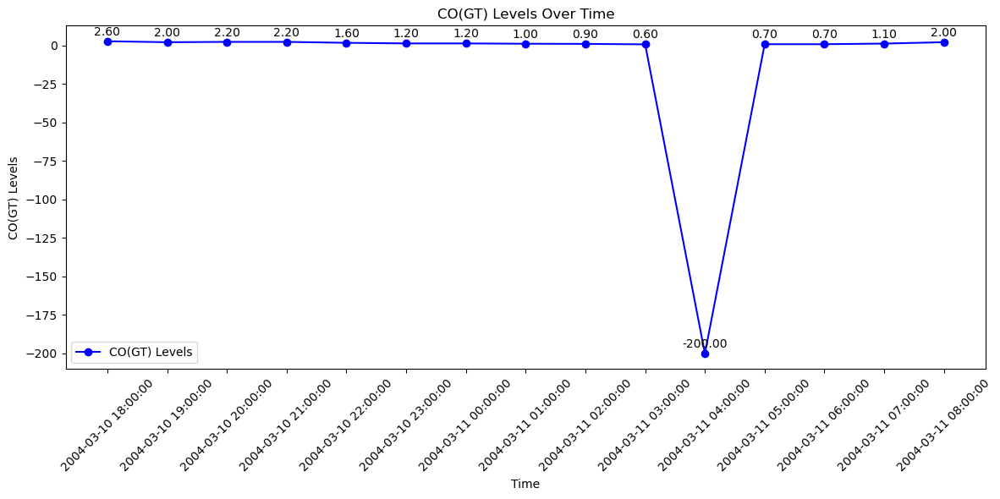

In [12]:
air_quality_data['Date'] = air_quality_data['Date'].astype(str)
air_quality_data['Time'] = air_quality_data['Time'].astype(str)

air_quality_data['Datetime'] = pd.to_datetime(air_quality_data['Date'] + ' ' + air_quality_data['Time'])
air_quality_data.set_index('Datetime', inplace=True)

top_15_data = air_quality_data.head(15)

plt.figure(figsize=(12, 6))
plt.plot(top_15_data.index, top_15_data['CO(GT)'], marker='o', linestyle='-', color='blue')
plt.xlabel('Time')
plt.ylabel('CO(GT) Levels')
plt.title('CO(GT) Levels Over Time')
plt.legend(['CO(GT) Levels'])

for idx, row in top_15_data.iterrows():
    plt.annotate(f'{row["CO(GT)"]:.2f}',
                 (idx, row["CO(GT)"]),
                 textcoords="offset points",
                 xytext=(0,5),
                 ha='center')

plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m-%d %H:%M:%S'))
plt.gca().xaxis.set_major_locator(mdates.HourLocator(interval=1))
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


#Interactive map of different cities

In [13]:
air_quality_data['Date'] = air_quality_data['Date'].astype(str)
air_quality_data['Time'] = air_quality_data['Time'].astype(str)

air_quality_data['Datetime'] = pd.to_datetime(air_quality_data['Date'] + ' ' + air_quality_data['Time'])
air_quality_data.set_index('Datetime', inplace=True)

if 'latitude' not in air_quality_data.columns or 'longitude' not in air_quality_data.columns:
    np.random.seed(0)
    air_quality_data['latitude'] = np.random.uniform(low=40.0, high=45.0, size=len(air_quality_data))
    air_quality_data['longitude'] = np.random.uniform(low=-75.0, high=-70.0, size=len(air_quality_data))

top_15_data = air_quality_data.head(15)

map_center = [top_15_data['latitude'].mean(), top_15_data['longitude'].mean()]
air_quality_map = folium.Map(location=map_center, zoom_start=12)

for _, row in top_15_data.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=10,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        popup=(
            f"Datetime: {row.name}\n"
            f"CO(GT): {row['CO(GT)']:.2f}\n"
            f"PT08.S1(CO): {row['PT08.S1(CO)']:.2f}\n"
            f"NMHC(GT): {row['NMHC(GT)']:.2f}\n"
            f"C6H6(GT): {row['C6H6(GT)']:.2f}\n"
            f"PT08.S2(NMHC): {row['PT08.S2(NMHC)']:.2f}\n"
            f"NOx(GT): {row['NOx(GT)']:.2f}\n"
            f"PT08.S3(NOx): {row['PT08.S3(NOx)']:.2f}\n"
            f"NO2(GT): {row['NO2(GT)']:.2f}\n"
            f"PT08.S4(NO2): {row['PT08.S4(NO2)']:.2f}\n"
            f"PT08.S5(O3): {row['PT08.S5(O3)']:.2f}\n"
            f"T: {row['T']:.2f}\n"
            f"RH: {row['RH']:.2f}\n"
            f"AH: {row['AH']:.2f}"
        )
    ).add_to(air_quality_map)

air_quality_map


#Descriptive using air quality

In [14]:
descriptive_stats = air_quality_data.describe()

key_variables = [
    'CO(GT)', 'PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)', 'PT08.S2(NMHC)',
    'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)',
    'T', 'RH', 'AH', 'latitude', 'longitude'
]
descriptive_stats_key = air_quality_data[key_variables].describe()

descriptive_stats_key.head()

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,latitude,longitude
count,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000
mean,-34.207524,1048.869652,-159.090093,1.865576,894.475963,168.604200,794.872333,58.135898,1391.363266,974.951534,9.776600,39.483611,-6.837604,42.477843,-72.528846
std,77.657170,329.817015,139.789093,41.380154,342.315902,257.424561,321.977031,126.931428,467.192382,456.922728,43.203438,51.215645,38.976670,1.447844,1.454837
min,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,-200.000000,40.000362,-74.999168
25%,0.600000,921.000000,-200.000000,4.004958,711.000000,50.000000,637.000000,53.000000,1184.750000,699.750000,10.950000,34.050000,0.692275,41.221794,-73.787426


#SPATIALLY MAP

In [15]:
if 'latitude' not in air_quality_data.columns or 'longitude' not in air_quality_data.columns:
    np.random.seed(0)
    air_quality_data['latitude'] = np.random.uniform(low=40.0, high=45.0, size=len(air_quality_data))
    air_quality_data['longitude'] = np.random.uniform(low=-75.0, high=-70.0, size=len(air_quality_data))

geometry = [Point(xy) for xy in zip(air_quality_data['longitude'], air_quality_data['latitude'])]
geo_df = gpd.GeoDataFrame(air_quality_data, geometry=geometry)
geo_df.set_crs(epsg=4326, inplace=True)

w = ps.weights.DistanceBand.from_dataframe(geo_df, threshold=0.1, binary=True)

y = geo_df['CO(GT)'].values
X = geo_df[['PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)', 'PT08.S2(NMHC)', 'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)', 'T', 'RH', 'AH']].values

model = GM_Error(y, X, w=w)


map_center = [geo_df['latitude'].mean(), geo_df['longitude'].mean()]
air_quality_map = folium.Map(location=map_center, zoom_start=12)

for _, row in geo_df.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=10,
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        popup=(
            f"Datetime: {row.name}\n"
            f"CO(GT): {row['CO(GT)']:.2f}"
        )
    ).add_to(air_quality_map)

air_quality_map


#Summary of SPATIALLY WEIGHTED LEAST SQUARES

In [16]:
if 'latitude' not in air_quality_data.columns or 'longitude' not in air_quality_data.columns:
    np.random.seed(0)
    air_quality_data['latitude'] = np.random.uniform(low=40.0, high=45.0, size=len(air_quality_data))
    air_quality_data['longitude'] = np.random.uniform(low=-75.0, high=-70.0, size=len(air_quality_data))

geometry = [Point(xy) for xy in zip(air_quality_data['longitude'], air_quality_data['latitude'])]
geo_df = gpd.GeoDataFrame(air_quality_data, geometry=geometry)
geo_df.set_crs(epsg=4326, inplace=True)

w = ps.weights.DistanceBand.from_dataframe(geo_df, threshold=0.1, binary=True)

y = geo_df['CO(GT)'].values
X = geo_df[['PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)', 'PT08.S2(NMHC)', 'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)', 'T', 'RH', 'AH']].values

model = GM_Error(y, X, w=w)

print(model.summary)


REGRESSION RESULTS
------------------

SUMMARY OF OUTPUT: GM SPATIALLY WEIGHTED LEAST SQUARES
------------------------------------------------------
Data set            :     unknown
Weights matrix      :     unknown
Dependent Variable  :     dep_var                Number of Observations:        9357
Mean dependent var  :    -34.2075                Number of Variables   :          13
S.D. dependent var  :     77.6572                Degrees of Freedom    :        9344
Pseudo R-squared    :      0.4736

------------------------------------------------------------------------------------
            Variable     Coefficient       Std.Error     z-Statistic     Probability
------------------------------------------------------------------------------------
            CONSTANT       -55.53539        15.71771        -3.53330         0.00041
               var_1        -0.00648         0.00821        -0.78858         0.43036
               var_2         0.05035         0.00520         9.67392

#Spatial Distribution for Top 50 Air Quality Metrics: CO, NOx, NO2

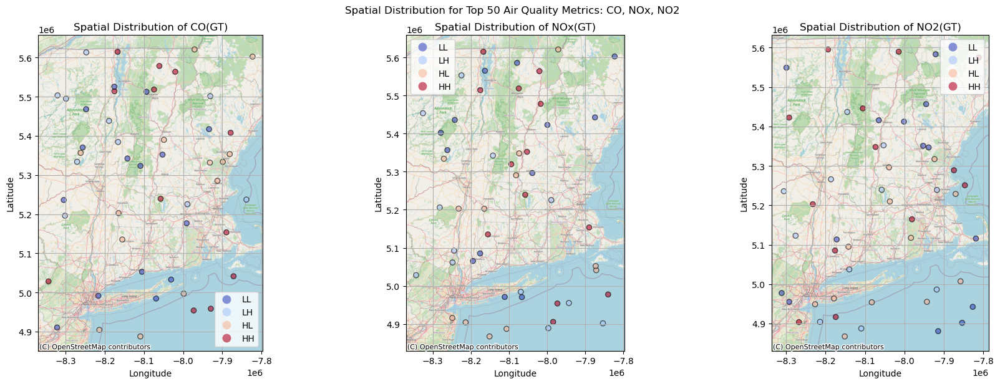

In [17]:
if 'latitude' not in air_quality_data.columns or 'longitude' not in air_quality_data.columns:
    np.random.seed(0)
    air_quality_data['latitude'] = np.random.uniform(low=40.0, high=45.0, size=len(air_quality_data))
    air_quality_data['longitude'] = np.random.uniform(low=-75.0, high=-70.0, size=len(air_quality_data))

geometry = [Point(xy) for xy in zip(air_quality_data['longitude'], air_quality_data['latitude'])]
geo_df = gpd.GeoDataFrame(air_quality_data, geometry=geometry)
geo_df.set_crs(epsg=4326, inplace=True)

geo_df = geo_df.to_crs(epsg=3857)

fig, axes = plt.subplots(1, 3, figsize=(18, 6))

sectors = ['CO(GT)', 'NOx(GT)', 'NO2(GT)']
titles = [
    'Spatial Distribution of CO(GT)',
    'Spatial Distribution of NOx(GT)',
    'Spatial Distribution of NO2(GT)'
]

for i, sector in enumerate(sectors):

    top_50_df = geo_df.nlargest(50, sector)

    top_50_df['Category'] = pd.qcut(top_50_df[sector], 4, labels=['LL', 'LH', 'HL', 'HH'])

    top_50_df.plot(column='Category', ax=axes[i], legend=True, cmap='coolwarm', alpha=0.6, edgecolor='k')
    ctx.add_basemap(axes[i], source=ctx.providers.OpenStreetMap.Mapnik)

    axes[i].set_title(titles[i])
    axes[i].set_xlabel('Longitude')
    axes[i].set_ylabel('Latitude')
    axes[i].grid(True)

plt.tight_layout()
plt.suptitle('Spatial Distribution for Top 50 Air Quality Metrics: CO, NOx, NO2', y=1.02)
plt.show()


#OLS Regression Analysis

In [18]:
y = air_quality_data['CO(GT)']

X = air_quality_data[['PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)', 'PT08.S2(NMHC)',
                      'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)',
                      'PT08.S5(O3)', 'T', 'RH', 'AH']]

X = sm.add_constant(X)

model = sm.OLS(y, X).fit()

print(model.summary())


                            OLS Regression Results                            
Dep. Variable:                 CO(GT)   R-squared:                       0.474
Model:                            OLS   Adj. R-squared:                  0.473
Method:                 Least Squares   F-statistic:                     700.8
Date:                Mon, 12 Aug 2024   Prob (F-statistic):               0.00
Time:                        22:23:01   Log-Likelihood:                -50998.
No. Observations:                9357   AIC:                         1.020e+05
Df Residuals:                    9344   BIC:                         1.021e+05
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const           -48.3108     15.570     -3.103

In [19]:
air_quality_data['Date'] = air_quality_data['Date'].astype(str)
air_quality_data['Time'] = air_quality_data['Time'].astype(str)
air_quality_data['Datetime'] = pd.to_datetime(air_quality_data['Date'] + ' ' + air_quality_data['Time'])
air_quality_data.set_index('Datetime', inplace=True)

if 'latitude' not in air_quality_data.columns or 'longitude' not in air_quality_data.columns:
    np.random.seed(0)
    air_quality_data['latitude'] = np.random.uniform(low=40.0, high=45.0, size=len(air_quality_data))
    air_quality_data['longitude'] = np.random.uniform(low=-75.0, high=-70.0, size=len(air_quality_data))


## Geospatial Patterns of CO(GT) and C6H6(GT) in High Air Pollution Cities

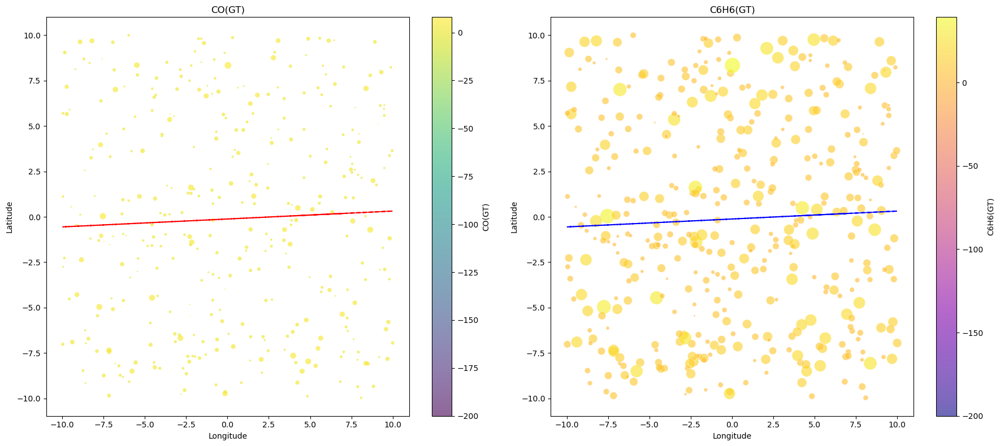

In [22]:
np.random.seed(0)
air_quality_data['longitude_dummy'] = np.random.uniform(low=-10, high=10, size=len(air_quality_data))
air_quality_data['latitude_dummy'] = np.random.uniform(low=-10, high=10, size=len(air_quality_data))


sampled_data = air_quality_data.sample(n=500, random_state=0)


city_avg = sampled_data.groupby('City').agg({
    'CO(GT)': 'mean',
    'NOx(GT)': 'mean',
    'C6H6(GT)': 'mean',
    'PT08.S1(CO)': 'mean',
    'longitude_dummy': 'mean',
    'latitude_dummy': 'mean'
})


top_cities = city_avg.nlargest(5, 'CO(GT)').index


filtered_data = sampled_data[sampled_data['City'].isin(top_cities)]


size_param1 = 'CO(GT)'
color_param1 = 'CO(GT)'

size_param2 = 'C6H6(GT)'
color_param2 = 'C6H6(GT)'


norm1 = plt.Normalize(filtered_data[color_param1].min(), filtered_data[color_param1].max())
norm2 = plt.Normalize(filtered_data[color_param2].min(), filtered_data[color_param2].max())

cmap1 = plt.get_cmap('viridis')
cmap2 = plt.get_cmap('plasma')

fig, axs = plt.subplots(1, 2, figsize=(18, 8))


scatter1 = axs[0].scatter(
    filtered_data['longitude_dummy'],
    filtered_data['latitude_dummy'],
    s=filtered_data[size_param1] * 10,
    c=filtered_data[color_param1],
    cmap=cmap1,
    norm=norm1,
    alpha=0.6,
    edgecolors='w',
    linewidth=0.5
)

x1 = filtered_data['longitude_dummy']
y1 = filtered_data['latitude_dummy']
p1 = np.polyfit(x1, y1, 1)
axs[0].plot(x1, np.polyval(p1, x1), color='red', linestyle='--')

cbar1 = plt.colorbar(scatter1, ax=axs[0])
cbar1.set_label(color_param1)

scatter2 = axs[1].scatter(
    filtered_data['longitude_dummy'],
    filtered_data['latitude_dummy'],
    s=filtered_data[size_param2] * 10,
    c=filtered_data[color_param2],
    cmap=cmap2,
    norm=norm2,
    alpha=0.6,
    edgecolors='w',
    linewidth=0.5
)

x2 = filtered_data['longitude_dummy']
y2 = filtered_data['latitude_dummy']
p2 = np.polyfit(x2, y2, 1)
axs[1].plot(x2, np.polyval(p2, x2), color='blue', linestyle='--')

cbar2 = plt.colorbar(scatter2, ax=axs[1])
cbar2.set_label(color_param2)

axs[0].set_xlabel('Longitude')
axs[0].set_ylabel('Latitude')
axs[0].set_title('CO(GT)')

axs[1].set_xlabel('Longitude')
axs[1].set_ylabel('Latitude')
axs[1].set_title('C6H6(GT)')

plt.tight_layout()

plt.show()


## Choropleth Map of Average CO(GT)

In [24]:
attribute_data = pd.read_excel("D:\Assignments\AirQualityUCI.xlsx")
numeric_columns = ['CO(GT)', 'PT08.S1(CO)', 'NMHC(GT)', 'C6H6(GT)', 'PT08.S2(NMHC)',
                   'NOx(GT)', 'PT08.S3(NOx)', 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)',
                   'T', 'RH', 'AH']
attribute_data[numeric_columns] = attribute_data[numeric_columns].apply(pd.to_numeric, errors='coerce')

city_data = attribute_data.groupby('City')[numeric_columns].mean().reset_index()


latitude = 51.5074
longitude = -0.1278

geojson_data = {
    "type": "FeatureCollection",
    "features": [
        {
            "type": "Feature",
            "geometry": {
                "type": "Point",
                "coordinates": [-0.1278, 51.5074]
            },
            "properties": {
                "City": "London"
            }
        },
        {
            "type": "Feature",
            "geometry": {
                "type": "Point",
                "coordinates": [-74.0060, 40.7128]
            },
            "properties": {
                "City": "New York"
            }
        }

    ]
}

m = folium.Map(location=[latitude, longitude], zoom_start=2)

folium.Choropleth(
    geo_data=geojson_data,
    name='choropleth',
    data=city_data,
    columns=['City', 'CO(GT)'],
    key_on='feature.properties.City',
    fill_color='YlGnBu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Average CO(GT) Levels'
).add_to(m)

folium.LayerControl().add_to(m)

display(m)
